bar chart: https://colab.research.google.com/github/pratapvardhan/notebooks/blob/master/barchart-race-matplotlib.ipynb

Earthquake example: https://colab.research.google.com/drive/1hakVC2bPlH31GnZ-BpMtRqQFwXQBRnP8?usp=sharing

In [ ]:
import matplotlib as mp
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math

import matplotlib.patches as patches
from matplotlib.patches import Polygon
import matplotlib.ticker as ticker

import matplotlib.animation as animation
mp.rcParams['animation.embed_limit'] = 2**128

from IPython.display import HTML
from google.colab import files


https://matplotlib.org/3.1.1/api/animation_api.html

# BASIC PRINCIPLE (FuncAnimation)
The FuncAnimation class runs another given function **n** times by passing in a range of values one at a time.

ArtistAnimation is a more sophisticated animation class that uses init and blit.

This notebook focuses on FuncAnimation.

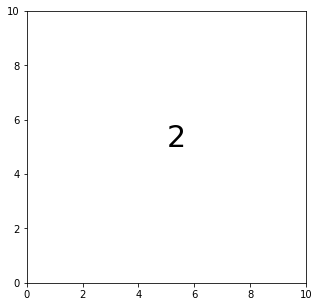

In [ ]:
figure, ax = plt.subplots(figsize = (5, 5))

def name_that_frame(current_frame):
  ax.clear()
  ax.set_xlim(0, 10)
  ax.set_ylim(0, 10)
  
  ax.text(5, 5, current_frame, size = 30)

name_that_frame(2)

In [ ]:
animator = animation.FuncAnimation(figure, name_that_frame, frames = range(5), interval = 1000, repeat = True)
HTML(animator.to_jshtml())

#GROWING DATAFRAME
LINE CHART EXAMPLE


In [ ]:
data = [[2012, 12], [2013, 11], [2014, 8], [2015, 12], [2016, 10]] 
df = pd.DataFrame(data, columns = ['Year', 'Wins']) 
print(df.head())


   Year  Wins
0  2012    12
1  2013    11
2  2014     8
3  2015    12
4  2016    10


In [ ]:
def print_wins(current_year):
  record = df[df['Year'] <= current_year]
  print(record)

print_wins(2017)

   Year  Wins
0  2012    12
1  2013    11
2  2014     8
3  2015    12
4  2016    10


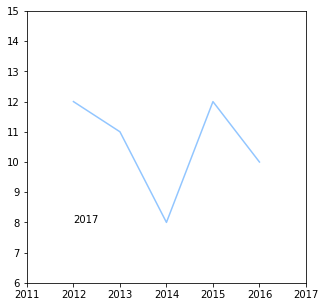

In [ ]:
figure_w, ax = plt.subplots(figsize = (5, 5))

def show_wins(current_year):
  ax.clear()
  ax.set_xlim(2011, 2017)
  ax.set_ylim(6, 15)

  record = df[df['Year'] <= current_year]

  ax.plot(record['Year'], record['Wins'])

  ax.text(2012, 8, current_year, size = 10)

show_wins(2017)

In [ ]:
animator = animation.FuncAnimation(figure_w, show_wins, frames = range(2010, 2017), interval = 500, repeat = True)
HTML(animator.to_jshtml())

SCATTERPLOT EXAMPLE

In [ ]:
df2 = pd.DataFrame(np.random.randint(0, 100, size=(100, 2)), columns = list('AB'))
df2.head()

,A,B
0,10,18
1,97,17
2,63,35
3,46,91
4,25,63


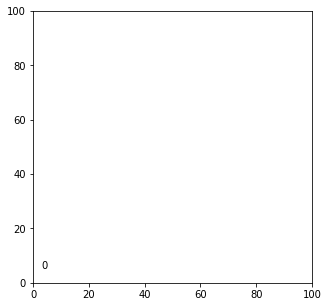

In [ ]:
figure_s, ax = plt.subplots(figsize = (5, 5))

def plot_points(current_frame):
  ax.clear()
  ax.set_xlim(0, 100)
  ax.set_ylim(0, 100)

  points = df2.iloc[:current_frame]

  ax.scatter(x = points['A'], y = points['B'])

  ax.text(3, 5, current_frame, size = 10)

animator = animation.FuncAnimation(figure_s, plot_points, frames = range(0, 30), interval = 1000, repeat = True)
HTML(animator.to_jshtml())


#MOVEMENT EXAMPLES
Tying anchor points to current frame

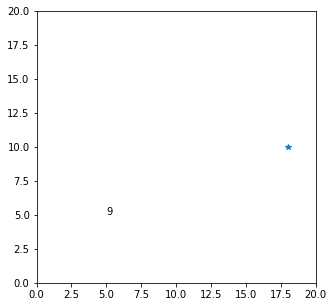

In [ ]:
figure_m, ax = plt.subplots(figsize = (5, 5))

def moving_anchor(current_frame): 
  ax.clear()
  ax.set_xlim(0, 20)
  ax.set_ylim(0, 20)
 
  x_anchor_point = 0 + current_frame*2
  ax.plot(x_anchor_point, 10,'*')
  
  ax.text(5, 5, current_frame, size = 10)


moving_anchor(9)


In [ ]:
animator = animation.FuncAnimation(figure_m, moving_anchor, frames = range(0, 21), interval = 100, repeat = True)
HTML(animator.to_jshtml())

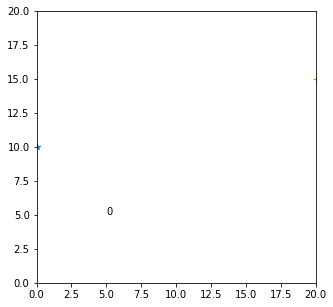

In [ ]:
figure_m, ax = plt.subplots(figsize = (5, 5))

def moving_anchor2(current_frame): 
  ax.clear()
  ax.set_xlim(0, 20)
  ax.set_ylim(0, 20)
 
  x_anchor_point_r = 0 + current_frame
  x_anchor_point_l = 20 - current_frame

  ax.plot(x_anchor_point_r, 10,'*')

  ax.plot(x_anchor_point_l, 15, '+')

  ax.text(5, 5, current_frame, size = 10)

animator = animation.FuncAnimation(figure_m, moving_anchor2, frames = range(0, 21), interval = 100, repeat = True)
HTML(animator.to_jshtml())

# **MORE EXAMPLES**

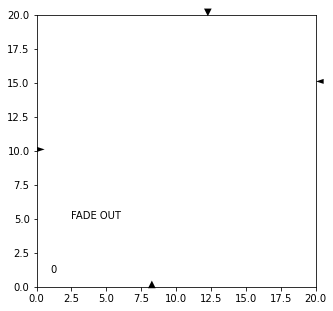

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))

def examples(current_frame): 
  ax.clear()
  ax.set_xlim(0, 20)
  ax.set_ylim(0, 20)
 
  x_anchor_point = 0 + current_frame
  y_anchor_point = 0 + current_frame
  
  ax.text(x_anchor_point, 10,'►')
  ax.text(20 - x_anchor_point, 15, '◄')

  ax.text(8, y_anchor_point,'▲')
  ax.text(12, 20 - y_anchor_point, '▼')

  ax.text(2.5, 6, 'FADE IN', alpha = current_frame/20)
  ax.text(2.5, 5, 'FADE OUT', alpha = 1 - current_frame/20)

  ax.text(1, 1, current_frame, size = 10)

animator = animation.FuncAnimation(fig, examples, frames = range(0, 21), interval = 100, repeat = True)
HTML(animator.to_jshtml())

# **PERIODIC EXAMPLES**
Add sin/cos to periodize function

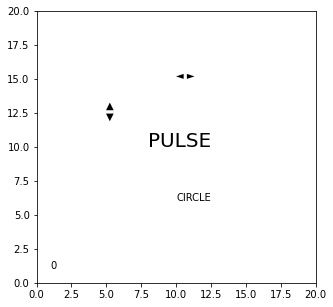

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))

def examples(current_frame): 
  ax.clear()
  ax.set_xlim(0, 20)
  ax.set_ylim(0, 20)
 
  x_anchor_point = 10 + math.sin(current_frame) * 2
  y_anchor_point = 10 + math.cos(current_frame) * 2
  
  ax.text(x_anchor_point, 15,'◄ ►')

  ax.text(5, y_anchor_point,'▲\n▼')

  ax.text(math.sin(current_frame) + 10, math.cos(current_frame) + 5, "CIRCLE")

  ax.text(8, 10, 'PULSE', size = 20 + math.sin(current_frame) * 2)

  ax.text(1, 1, current_frame, size = 10)

animator = animation.FuncAnimation(fig, examples, frames = range(0, 41), interval = 100, repeat = True)
HTML(animator.to_jshtml())

# EXPORT

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

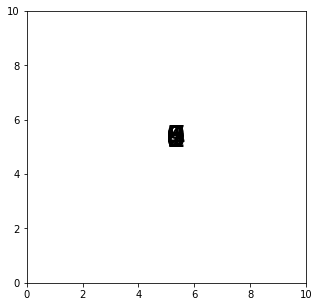

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
animator = animation.FuncAnimation(fig, name_that_frame, frames=range(0, 10),interval = 100, repeat = True, repeat_delay = 10000)
# animator.save('animation.mp4')
# files.download('animation.mp4')

# FOR FUN
**Dynamic bar chart with Atari-quality graphics**

In [ ]:
def travel(current_year):
   adj_year = current_year%10
   y_anchor = 2 - (adj_year/5)
   ax.plot([0, 10], [y_anchor - 1, y_anchor - 1], linewidth = 0.9, color = 'black', zorder = 0)
   ax.plot([0, 10], [y_anchor, y_anchor], linewidth = 0.9, color = 'black', zorder = 0)
   ax.plot([0, 10], [min(2, y_anchor + 1), min(2, y_anchor + 1)], linewidth = 0.9, color = 'black', zorder = 0)

   points1 = [(0,2), (5,2), (2.5,0), (0,0)]
   points2 = [(10,2), (5,2), (7.5,0), (10, 0)]
   polygon = plt.Polygon(points1, closed = True, color = 'green')
   polygon2 = plt.Polygon(points2, closed = True, color = 'green')

   ax.add_patch(polygon)
   ax.add_patch(polygon2)

In [ ]:
def hist_height(current_year):
  x = 1.5
  if current_year > 1910:
    x = 2.5
  if current_year > 1930:
    x = 4
  if current_year > 1970:
    x = 4.5
  if current_year > 2000:
    x = 5.5
  if current_year > 2010:
    x = 8.1 
  return(x)

In [ ]:
def building(height):
  face = plt.Rectangle((0,0), 1.8, height, color = 'lightgrey', zorder = 100000)
  ax.add_patch(face)
  points_side = [(1.8,0),(4.5, 1.9),(4.5, 1.9 + height/10),(1.8, height)]
  side = plt.Polygon(points_side, closed = True, color = 'grey',  zorder = 100000)
  ax.add_patch(side)
  points_top = [(0, height),(1.8, height),(4.5, 1.9 + height/10)]
  top = plt.Polygon(points_top, closed = True, color = "darkgrey",  zorder = 100000)
  if height < 2:
    ax.add_patch(top)
  
  

In [ ]:
def skyline():
  for i in range (0, 20):
    x = np.random.randint(0, 9) + np.random.randint(0, 3)
    y = 2
    w = np.random.randint(20, 100)/100
    h = np.random.randint(20, 50)/100
    build = plt.Rectangle((x, y), w, h, color = "dimgrey", zorder = 1)
    ax.add_patch(build)
  for i in range (0, 20):
    x = np.random.randint(0, 9) + np.random.randint(0, 3)
    y = 2
    w = np.random.randint(20, 800)/100
    h = np.random.randint(0, 20)/100
    build = plt.Rectangle((x, y), w, h, color = "dimgrey", zorder = 1)
    ax.add_patch(build)
  sky = plt.Rectangle((0, 2), 10, 8, color = 'lightblue', zorder = 0)
  ax.add_patch(sky)
 

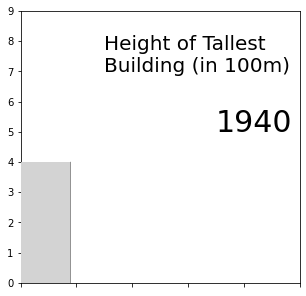

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))


def simple_height(current_year):
  ax.clear()
  ax.set_xlim(0, 10)
  ax.set_ylim(0, 9)
  ax.set_xticklabels([])
  height = hist_height(current_year)
  building(height)
  ax.text(7, 5, current_year, size = 30)
  ax.text(3, 7, 'Height of Tallest\nBuilding (in 100m)', size = 20)
  # hide side
  points_mask = [(1.8,6), (5,6), (5,0), (1.8,0)]
  mask = plt.Polygon(points_mask, closed = True, color = 'white',  zorder = 200000)
  ax.add_patch(mask)

simple_height(1940)

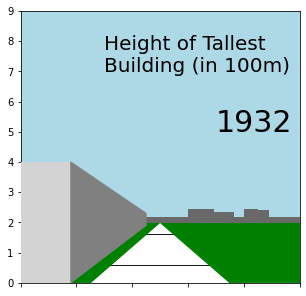

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))


def metro(current_year):
  ax.clear()
  ax.set_xlim(0, 10)
  ax.set_ylim(0, 9)
  ax.set_xticklabels([])
  height = hist_height(current_year)
  travel(current_year)
  building(height)
  skyline()
  ax.text(7, 5, current_year, size = 30)
  ax.text(3, 7, 'Height of Tallest\nBuilding (in 100m)', size = 20)

metro(1932)

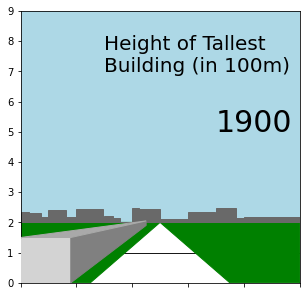

In [ ]:
#animation
fig, ax = plt.subplots(figsize=(5, 5))
animator = animation.FuncAnimation(fig, metro, frames=range(1900,2030),interval = 75, repeat = True, repeat_delay = 10000)
HTML(animator.to_jshtml())

**Sine wave (from matplotlib.org)**

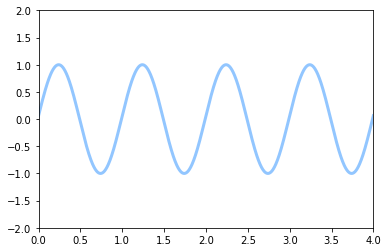

In [ ]:
plt.style.use('seaborn-pastel')

fig = plt.figure()
ax = plt.axes(xlim=(0, 4), ylim=(-2, 2))
line, = ax.plot([], [], lw=3)

def init():
    line.set_data([], [])
    return line,
def animate(i):
    x = np.linspace(0, 4, 1000)
    y = np.sin(2 * np.pi * (x - 0.01 * i))
    line.set_data(x, y)
    return line,

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20, blit=True)
HTML(anim.to_jshtml())

**Raindrop plot**  
(Quick and dirty not-at-all precise example)



In [ ]:
df3 = pd.DataFrame(np.random.randint(40, 90, size=(100, 2)), columns = ['Lat','Long'])
df3.head()

,Lat,Long
0,75,74
1,42,40
2,81,58
3,57,40
4,72,69


In [ ]:
import matplotlib.image as mpimg
bg = mpimg.imread("https://github.com/ejhaselden/CS06-MISC/raw/master/san_andreas.png")


In [ ]:
def drop0(x, y, local_frame):
  local_frame = local_frame%10
  s = min(local_frame * 50, 600)
  fade = max(0, 1 - local_frame/10)
  ax.scatter(x = x, y = y, s = s, facecolor = 'none', edgecolor = 'blue', alpha = fade)

In [ ]:
def drop1(x, y, local_frame):
  local_frame = local_frame%10
  s = min(local_frame * 50, 600)
  fade = max(0, 1 - local_frame/10)
  ax.scatter(x = x, y = y, s = s, facecolor = 'none', edgecolor = 'blue', alpha = fade)
 

In [ ]:
def drop2(x, y, local_frame):
  local_frame = local_frame%10
  s = min(local_frame * 50, 600)
  fade = max(0, 1 - local_frame/10)
  ax.scatter(x = x, y = y, s = s, facecolor = 'none', edgecolor = 'blue', alpha = fade)

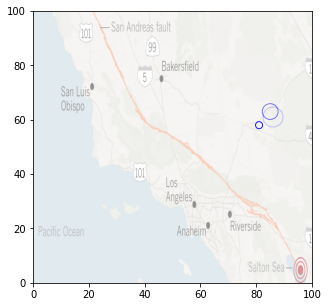

In [ ]:
fig, ax = plt.subplots(figsize = (5, 5))


def rainfall(current_frame):
  ax.clear()
  ax.set_xlim(0, 100)
  ax.set_ylim(0, 100)
  ax.imshow(bg, extent=[0, 100, 0, 100], aspect  = 'auto', alpha = .5)
  index =  int(current_frame/20)
  current_loc = df3.iloc[index]
 
  x = current_loc['Lat']
  y = current_loc['Long']
  drop0(x, y, current_frame)
  x = x + 5
  y = y + 3
  drop1(x, y, current_frame - 3,)
  x = x - 1
  y = y + 2
  drop2(x, y, current_frame - 6,)


rainfall(41)

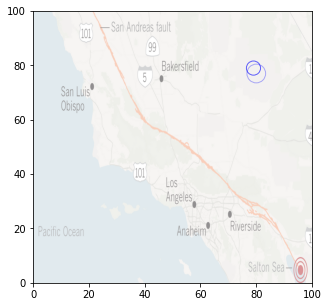

In [ ]:
fig, ax = plt.subplots(figsize=(5, 5))
animator = animation.FuncAnimation(fig, rainfall, frames=range(0, 100),interval = 100, repeat = True, repeat_delay = 10000)
HTML(animator.to_jshtml())

**How to Make a Pie Chart**

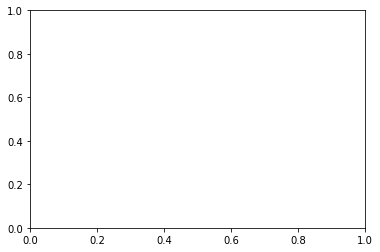

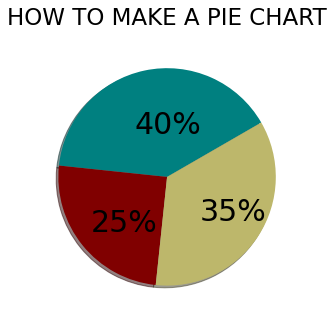

In [ ]:
fig1, ax = plt.subplots()

def bars(bar_ref):
  aspect = min(1, bar_ref * .1)
  ax.set_aspect(aspect)

  aspect_offset = 10
  split_rate = (bar_ref - aspect_offset) * .02
  add_text = 3

  if aspect < 1:
    aleft = -1
    bleft = -0.1
    cleft = -1
    awidth = 1.5
    bwidth = .9
    cwidth = .9
  else:
    aleft = -1
    bleft = max(-.33, -0.1 - split_rate)
    cleft = min(.33, -1 + 3*split_rate)
    awidth = max(.66, 1.5 - 2*split_rate)
    bwidth = max(.66, .9 - 2*split_rate)
    cwidth = max(.66, .9 - 2*split_rate)

  if bar_ref > 35:
    ax.text(aleft + awidth*.2, .4, '40%', size = 25, zorder = 99)
    ax.text(bleft + bwidth*.2, .4, '35%', size = 25, zorder = 99)
    ax.text(cleft + cwidth*.2, .4, '25%', size = 25, zorder = 99)
    ax.text(0, 1.4, 'HOW TO MAKE A PIE CHART', size = 23, ha = 'center')

  if bar_ref > 55:
    ax.text(0, -.5, "DON'T", size = 45, ha = 'center')
  if bar_ref > 62:
    ax.text(0, -1, "MAKE", size = 45, ha = 'center')
  if bar_ref > 69:
    ax.text(0, -1.5, "PIE CHARTS", size = 45, ha = 'center')

  a = plt.Rectangle((aleft, 0), awidth, 1.35, color = 'teal', zorder = 3)
  b = plt.Rectangle((bleft, 0), bwidth, 1.05, color = 'darkkhaki', zorder = 4)
  c = plt.Rectangle((cleft, 0), cwidth, .75, color = 'maroon', zorder = 5)
  ax.add_patch(a)
  ax.add_patch(b)
  ax.add_patch(c)

def pie(ref):
  ax.clear()

  split_alpha = 0
  switch_frame = 20
  start_delay = 10
  freeze_frame = 60
  
  if ref < start_delay:
    frame = 0
    ax.text(-.3, .4, '40%', size = 30, zorder = 99)
    ax.text(-.7, -.5, '25%', size = 30, zorder = 99)
    ax.text(.3, -.4, '35%', size = 30, zorder = 99)
    ax.text(0, 1.4, 'HOW TO MAKE A PIE CHART', size = 23, ha = 'center')
    

  else:
    frame = ref - start_delay
  pie_aspect = max(.01, (1 - frame/20))
  if  frame < switch_frame:
    pie_alpha = 1
    split_alpha = 0
  else:
    pie_alpha = 0
    split_alpha = 1

  sizes = [40, 25, 35]
  
  pie = ax.pie(sizes, shadow=True, startangle=30, colors = ['teal', 'maroon', 'darkkhaki'])
  ax.set_aspect(pie_aspect)

  face = plt.Rectangle((-1.1,-10), 2.2, 20, color = 'white', zorder = 2, alpha = split_alpha)
  ax.add_patch(face)
   

  if frame > switch_frame:
    
    bars(frame - switch_frame)
    
  
  # ax.text(0, 0, frame, size = 30, zorder = 99)
  plt.show()

# pie(0)

fig1, ax = plt.subplots(figsize=(5,5))
animator = animation.FuncAnimation(fig1, pie, frames=range(0, 110), interval = 100, repeat = True, repeat_delay = 10000)
HTML(animator.to_jshtml())